In [ ]:
!python -m pip install -r requirements.txt


In [ ]:
!pip install imgaug

# Load and Augment an Image
* Source : https://nbviewer.jupyter.org/github/aleju/imgaug-doc/blob/master/notebooks/A01%20-%20Load%20and%20Augment%20an%20Image.ipynb


## Load and Show an Image


In [48]:
%matplotlib inline
import imageio
import imgaug as ia
import pandas as pd

Original:


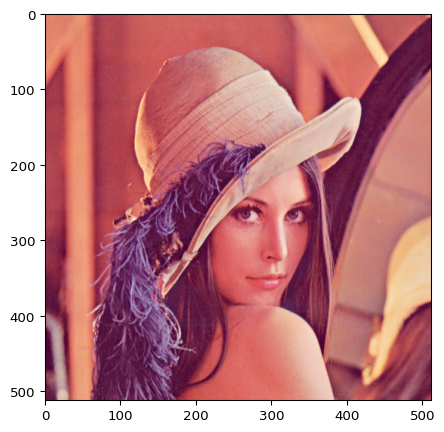

In [17]:
image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")

print("Original:")
ia.imshow(image)

## Augment the Image


Augmented:


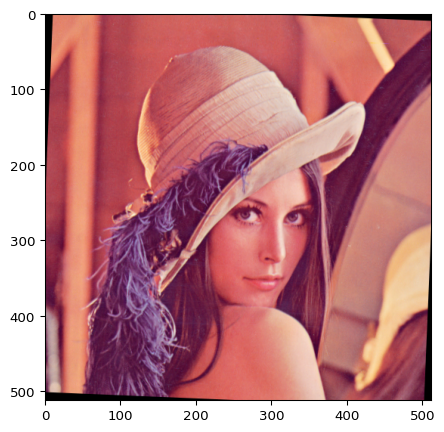

In [18]:
from imgaug import augmenters as iaa
ia.seed(4)

rotate = iaa.Affine(rotate=(-25, 25))
image_aug = rotate(image=image)

print("Augmented:")
ia.imshow(image_aug)

## Augment a Batch of Images


Augmented batch:


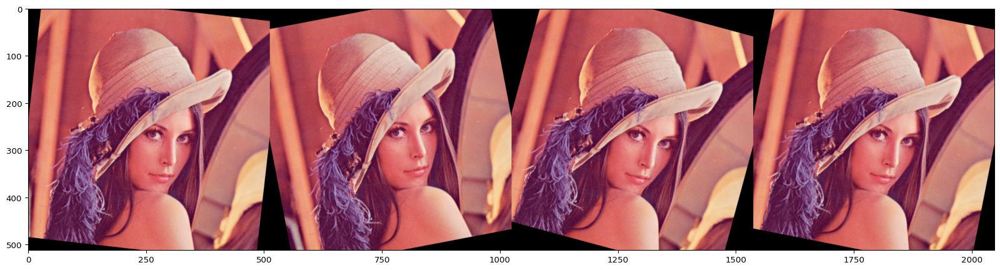

In [19]:
import numpy as np

images = [image, image, image, image]
images_aug = rotate(images=images)

print("Augmented batch:")
ia.imshow(np.hstack(images_aug))

Augmented:


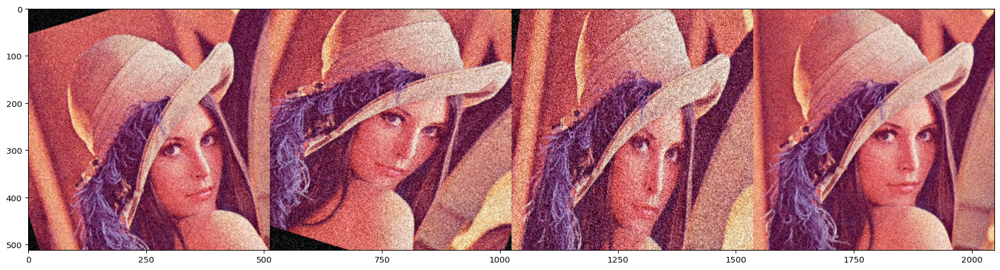

In [20]:
## Use Many Augmentation Techniques Simultaneously
seq = iaa.Sequential([
    iaa.Affine(rotate=(-25, 25)),
    iaa.AdditiveGaussianNoise(scale=(10, 60)),
    iaa.Crop(percent=(0, 0.2))
])

images_aug = seq(images=images)

print("Augmented:")
ia.imshow(np.hstack(images_aug))

Augmented:


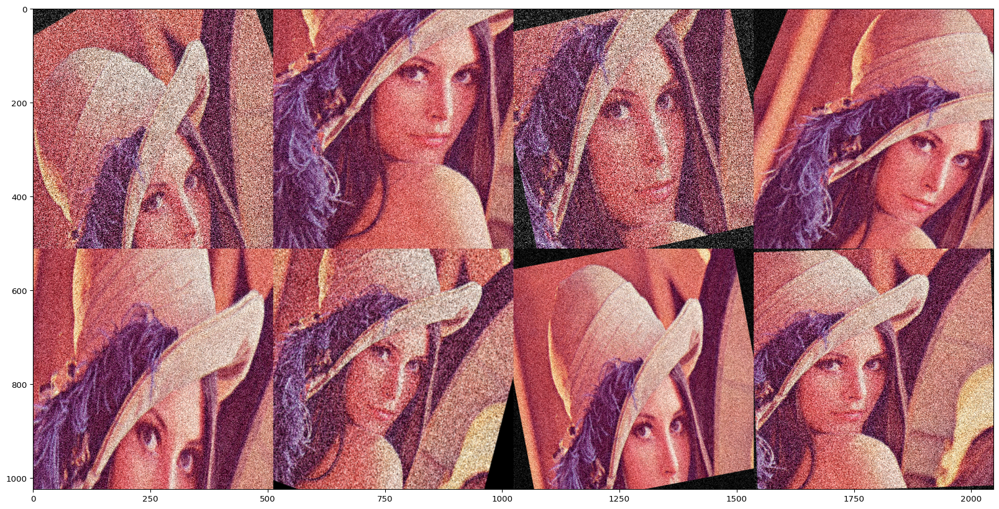

In [21]:
seq = iaa.Sequential([
    iaa.Affine(rotate=(-25, 25)),
    iaa.AdditiveGaussianNoise(scale=(30, 90)),
    iaa.Crop(percent=(0, 0.4))
], random_order=True)

images_aug = [seq(image=image) for _ in range(8)]

print("Augmented:")
ia.imshow(ia.draw_grid(images_aug, cols=4, rows=2))

In [22]:
# __m="iaa";__k="out";print('\n'.join([_s for _s in dir(eval(__m)) if _s.find(__k) >= 0 ]))
?iaa.cutout

Signature:
iaa.cutout(
    image,
    x1,
    y1,
    x2,
    y2,
    fill_mode='constant',
    cval=0,
    fill_per_channel=False,
    seed=None,
)
Docstring:
Fill a single area within an image using a fill mode.

This cutout method uses the top-left and bottom-right corner coordinates
of the cutout region given as absolute pixel values.

.. note::

    Gaussian fill mode will assume that float input images contain values
    in the interval ``[0.0, 1.0]`` and hence sample values from a
    gaussian within that interval, i.e. from ``N(0.5, std=0.5/3)``.

**Supported dtypes**:

See :func:`~imgaug.augmenters.arithmetic.cutout_`.

Added in 0.4.0.

Parameters
----------
image : ndarray
    Image to modify.

x1 : number
    See :func:`~imgaug.augmenters.arithmetic.cutout_`.

y1 : number
    See :func:`~imgaug.augmenters.arithmetic.cutout_`.

x2 : number
    See :func:`~imgaug.augmenters.arithmetic.cutout_`.

y2 : number
    See :func:`~imgaug.augmenters.arithmetic.cutout_`.

fill_mode : {'

Image 0 (input shape: (257, 286, 3), output shape: (257, 286, 3))


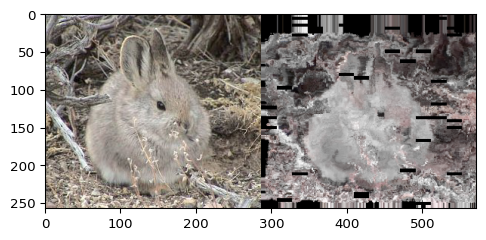

Image 1 (input shape: (536, 800, 3), output shape: (536, 800, 3))


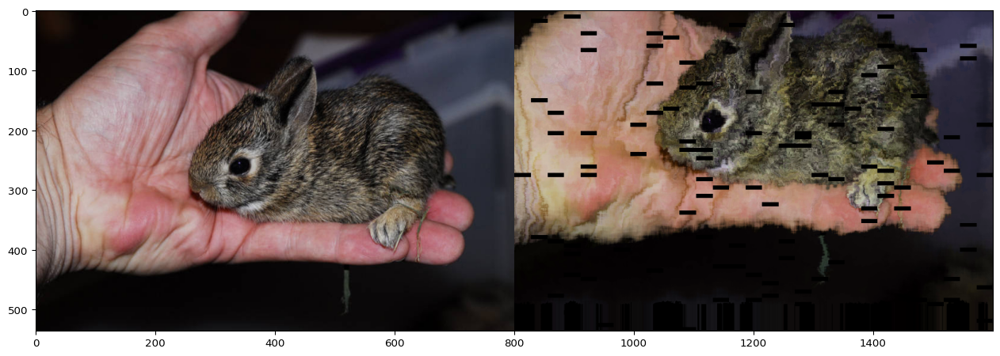

Image 2 (input shape: (289, 520, 3), output shape: (289, 520, 3))


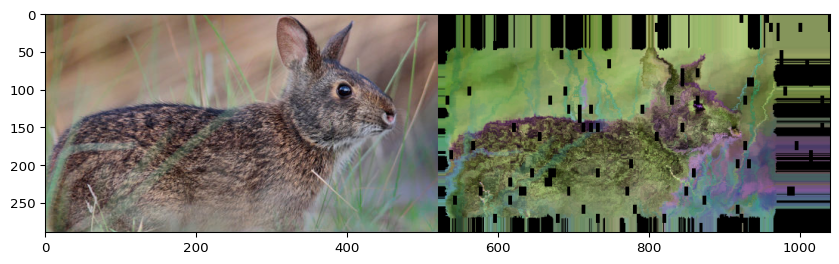

In [23]:
## Augmenting Images of Different Sizes
seq = iaa.Sequential([
    iaa.CropAndPad(percent=(-0.2, 0.2), pad_mode="edge"),  # crop and pad images
    iaa.AddToHueAndSaturation((-60, 60)),  # change their color
    iaa.ElasticTransformation(alpha=90, sigma=9),  # water-like effect
    iaa.CoarseDropout((0.0, 0.05), size_percent=(0.02, 0.25))  # replace one squared area within the image by a constant intensity value
], random_order=True)

# load images with different sizes
images_different_sizes = [
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/e/ed/BRACHYLAGUS_IDAHOENSIS.jpg"),
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/c/c9/Southern_swamp_rabbit_baby.jpg"),
    imageio.imread("https://upload.wikimedia.org/wikipedia/commons/9/9f/Lower_Keys_marsh_rabbit.jpg")
]

# augment them as one batch
images_aug = seq(images=images_different_sizes)

# visualize the results
print("Image 0 (input shape: %s, output shape: %s)" % (images_different_sizes[0].shape, images_aug[0].shape))
ia.imshow(np.hstack([images_different_sizes[0], images_aug[0]]))

print("Image 1 (input shape: %s, output shape: %s)" % (images_different_sizes[1].shape, images_aug[1].shape))
ia.imshow(np.hstack([images_different_sizes[1], images_aug[1]]))

print("Image 2 (input shape: %s, output shape: %s)" % (images_different_sizes[2].shape, images_aug[2].shape))
ia.imshow(np.hstack([images_different_sizes[2], images_aug[2]]))

# Basic Example
* https://imgaug.readthedocs.io/en/latest/source/examples_basics.html

# With Keypoints or Bounding Box

## Example: Augment Images and Keypoints



In [24]:
import numpy as np
import imgaug.augmenters as iaa

images = np.zeros((2, 128, 128, 3), dtype=np.uint8)  # two example images
images[:, 64, 64, :] = 255
points = [
    [(10.5, 20.5)],  # points on first image
    [(50.5, 50.5), (60.5, 60.5), (70.5, 70.5)]  # points on second image
]

seq = iaa.Sequential([
    iaa.AdditiveGaussianNoise(scale=0.05*255),
    iaa.Affine(translate_px={"x": (1, 5)})
])

# augment keypoints and images
images_aug, points_aug = seq(images=images, keypoints=points)

print("Image 1 center", np.argmax(images_aug[0, 64, 64:64+6, 0]))
print("Image 2 center", np.argmax(images_aug[1, 64, 64:64+6, 0]))
print("Points 1", points_aug[0])
print("Points 2", points_aug[1])


Image 1 center 1
Image 2 center 3
Points 1 [(11.5, 20.5)]
Points 2 [(53.5, 50.5), (63.5, 60.5), (73.5, 70.5)]


## Example: Augment Images and Bounding Boxes



In [25]:
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa

images = np.zeros((2, 128, 128, 3), dtype=np.uint8)  # two example images
images[:, 64, 64, :] = 255
polygons = [
    [ia.Polygon([(10.5, 10.5), (50.5, 10.5), (50.5, 50.5)])],
    [ia.Polygon([(0.0, 64.5), (64.5, 0.0), (128.0, 128.0), (64.5, 128.0)])]
]

seq = iaa.Sequential([
    iaa.AdditiveGaussianNoise(scale=0.05*255),
    iaa.Affine(translate_px={"x": (1, 5)})
])

images_aug, polygons_aug = seq(images=images, polygons=polygons)

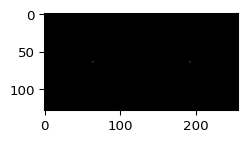

In [26]:
ia.imshow(np.hstack([images[0], images[0]]))

# Example: Visualize Augmented Non-Image Data



In [51]:
import numpy as np
import imgaug as ia

image = np.zeros((64, 64, 3), dtype=np.uint8)



## points

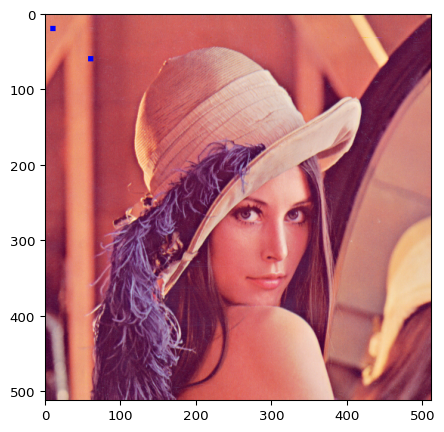

(512, 512, 3)


In [50]:
kps = [ia.Keypoint(x=10.5, y=20.5), ia.Keypoint(x=60.5, y=60.5)]
kpsoi = ia.KeypointsOnImage(kps, shape=image.shape)
image_with_kps = kpsoi.draw_on_image(image, size=7, color=(0, 0, 255))
ia.imshow(image_with_kps)



# bbs



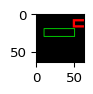

In [29]:
bbsoi = ia.BoundingBoxesOnImage([
    ia.BoundingBox(x1=10.5, y1=20.5, x2=50.5, y2=30.5)
], shape=image.shape)
image_with_bbs = bbsoi.draw_on_image(image)
image_with_bbs = ia.BoundingBox(
    x1=50.5, y1=10.5, x2=100.5, y2=16.5
).draw_on_image(image_with_bbs, color=(255, 0, 0), size=3)
ia.imshow(image_with_bbs)


# polygons


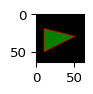

In [30]:

psoi = ia.PolygonsOnImage([
    ia.Polygon([(10.5, 20.5), (50.5, 30.5), (10.5, 50.5)])
], shape=image.shape)
image_with_polys = psoi.draw_on_image(
    image, alpha_points=0, alpha_face=0.5, color_lines=(255, 0, 0))
ia.imshow(image_with_polys)


In [31]:
image_with_polys.__class__

numpy.ndarray


# heatmaps


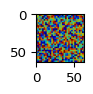

In [32]:
hms = ia.HeatmapsOnImage(np.random.random(size=(32, 32, 1)).astype(np.float32),
                         shape=image.shape)
image_with_hms = hms.draw_on_image(image)
ia.imshow(np.array( image_with_hms[0]) )

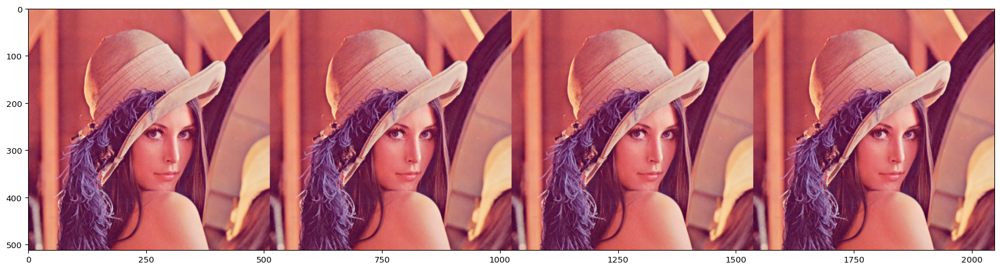

In [102]:
from imgaug import augmenters as iaa
import numpy as np

image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")
images = [image, image, image, image]
ia.imshow(np.hstack(images))


## always horizontally flip each input image


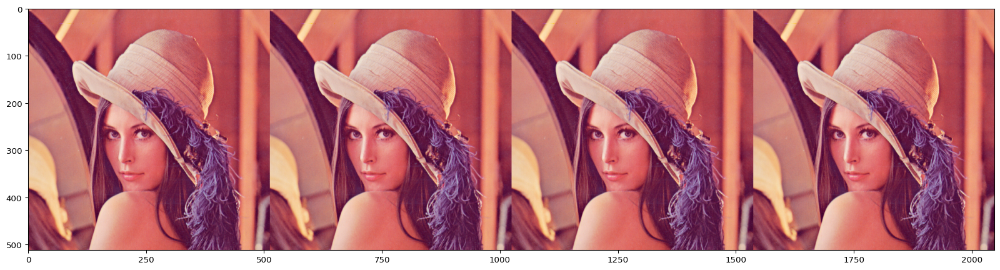

In [34]:
images_aug = iaa.Fliplr(1.0)(images=images)
ia.imshow(np.hstack(images_aug))



## vertically flip each input image with 90% probability


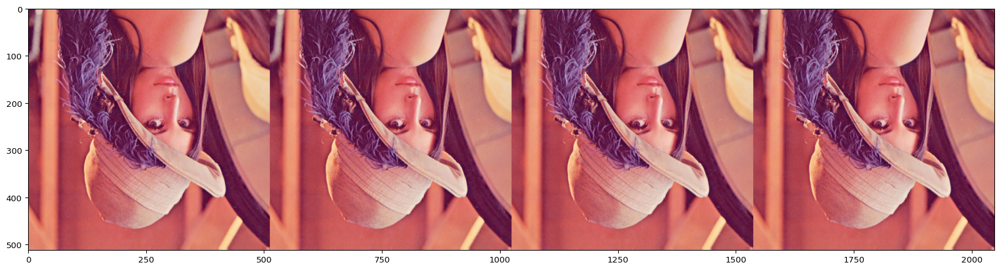

In [35]:
images_aug = iaa.Flipud(0.9)(images=images)
ia.imshow(np.hstack(images_aug))



## blur 50% of all images using a gaussian kernel with a sigma of 3.0


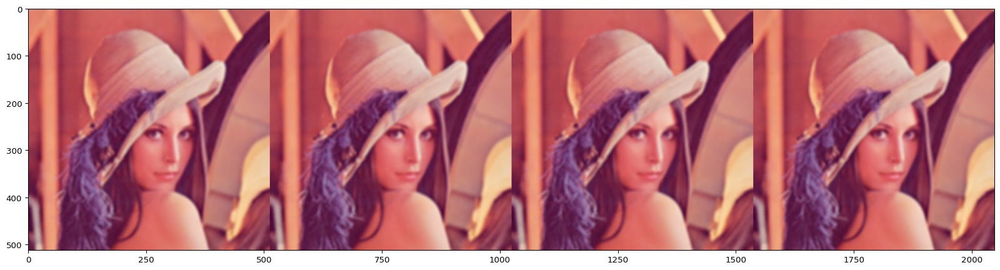

In [36]:
images_aug = iaa.Sometimes(0.5, iaa.GaussianBlur(3.0))(images=images)
ia.imshow(np.hstack(images_aug))

# Crop
* https://junyoung-jamong.github.io/machine/learning/2019/01/23/%EB%B0%94%EC%9A%B4%EB%94%A9%EB%B0%95%EC%8A%A4%EB%A5%BC-%ED%8F%AC%ED%95%A8%ED%95%9C-%EC%9D%B4%EB%AF%B8%EC%A7%80-%EC%A6%9D%ED%8F%AD%EC%8B%9C%ED%82%A4%EA%B8%B0-with-imgaug.html

In [1]:
import imgaug.augmenters as iaa
import imageio
import imgaug as ia
import numpy as np

In [9]:
image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")

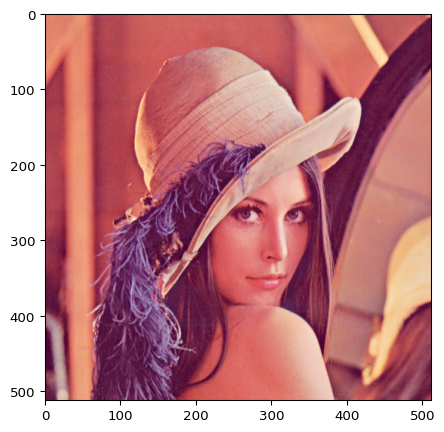

In [121]:
ia.imshow(image)

## Single position - no Sequential

(64, 64, 3) (64, 64, 3)


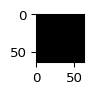

In [52]:
# aug = iaa.CropToMultiplesOf(height_multiple=10, width_multiple=6)

# aug = iaa.CropToPowersOf(2,2)
# aug=iaa.CropAndPad(percent=(0,0))
# aug=iaa.CropToFixedSize(width=200, height=200,position='left-top')
# aug = iaa.CropToPowersOf(height_base=100, width_base=100)
# aug = iaa.CropToMultiplesOf(height_multiple=10, width_multiple=6)

aug=iaa.CropToFixedSize(width=200, height=200,position='center')

images_aug = aug(images=[image])

print(images_aug[0].shape,image.shape)
# ia.imshow(images_aug[0])
ia.imshow(np.hstack(images_aug))

## Multi position - no Sequential

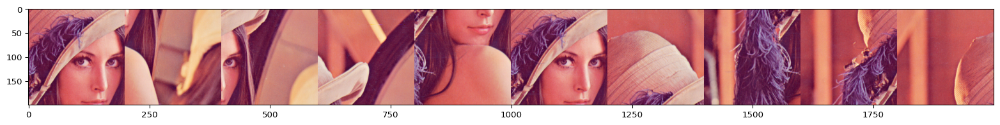

In [115]:
image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")
images_croped=[]
position=[ 'center', 'left-top', 'left-center', 'left-bottom', 'center-top', 'center-center', 'center-bottom', 'right-top', 'right-center', 'right-bottom']

for p in position:
    aug=iaa.CropToFixedSize(width=200, height=200,position=p)
    image_aug = aug(images=[image])[0]
    images_croped.append(image_aug)
ia.imshow(np.hstack(images_croped))    


## Multi position - with Sequential

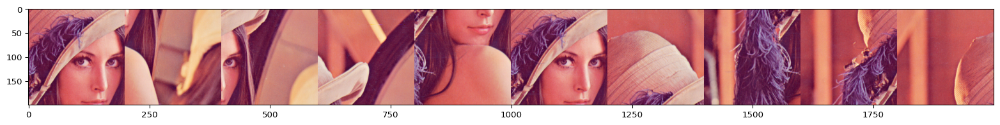

In [16]:
image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")
images_croped=[]
position=[ 'center', 'left-top', 'left-center', 'left-bottom', 'center-top', 'center-center', 'center-bottom', 'right-top', 'right-center', 'right-bottom']

for p in position:
    seq = iaa.Sequential([
        iaa.CropToFixedSize(width=200, height=200,position=p)
    ])
    seq_det = seq.to_deterministic()
    image_aug = seq_det.augment_images([image])[0]
    images_croped.append(image_aug)
    
    
ia.imshow(np.hstack(images_croped))    

## Bounding Boxes on Image


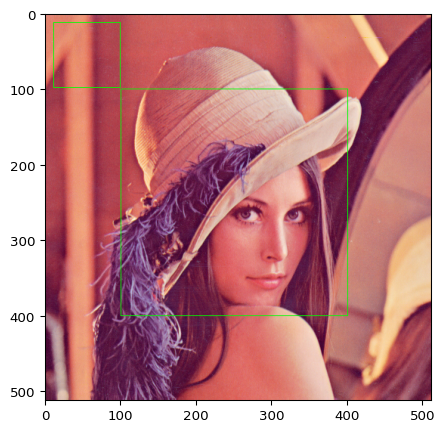

In [17]:

def bbsOnImage(img,bs):

    bbs = ia.BoundingBoxesOnImage(bs, shape=img.shape)

    image_with_bbs = bbs.draw_on_image(img)

    # image_with_bbs = ia.BoundingBox(
    #     x1=50.5, y1=10.5, x2=100.5, y2=16.5
    # ).draw_on_image(image_with_bbs, color=(255, 0, 0), size=3)
    return image_with_bbs


bs=[
    ia.BoundingBox(x1=100., y1=100., x2=400., y2=400),
    ia.BoundingBox(x1=11., y1=12., x2=99., y2=98)

]
ia.imshow(bbsOnImage(image,bs))

## Multi position - with Sequential - with Bounding Boxes

BoundingBoxesOnImage([BoundingBox(x1=-56.0000, y1=-56.0000, x2=244.0000, y2=244.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=-212.0000, y1=-212.0000, x2=88.0000, y2=88.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=-212.0000, y1=-56.0000, x2=88.0000, y2=244.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=-212.0000, y1=100.0000, x2=88.0000, y2=400.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=-56.0000, y1=-212.0000, x2=244.0000, y2=88.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=-56.0000, y1=100.0000, x2=244.0000, y2=400.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=100.0000, y1=-212.0000, x2=400.0000, y2=88.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBox(x1=100.0000, y1=-56.0000, x2=400.0000, y2=244.0000, label=None)], shape=(200, 200, 3))
BoundingBoxesOnImage([BoundingBo

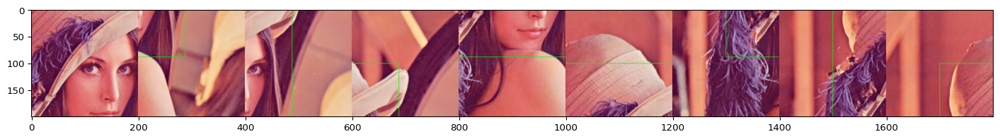

In [53]:
  
def imgAugCropTo9(img,bs,isImageWithBb=False,size=400):
    bbs = ia.BoundingBoxesOnImage(bs, shape=img.shape)
    images_croped=[]
    bbs_croped=[]
    position=[ 'center', 'left-top', 'left-center', 'left-bottom', 'center-top', 'center-bottom', 'right-top', 'right-center', 'right-bottom']

    for p in position:
        seq = iaa.Sequential([
            iaa.CropToFixedSize(width=size, height=size,position=p)
        ])
        seq_det = seq.to_deterministic()

        image_aug = seq_det.augment_images([img])[0]

        bbs_aug   = seq_det.augment_bounding_boxes([bbs])[0]
        bbs_croped.append(bbs_aug)
        # print(p,bbs_aug)


        image_aug=bbs_aug.draw_on_image(image_aug) if isImageWithBb else image_aug
        images_croped.append(image_aug)

    return (images_croped,bbs_croped)

# fname='000002_jpg.rf.14c099486ff0a2df2d20d82da93b46f5'
# bb_path=labels_path+fname+'.txt'
# img_path=images_super_path+fname+'.jpg'

# img = imageio.imread(img_path)
# bbsYolo5=pd.read_csv(bb_path,sep=" ", header=None)
# bs=bbsYolo5ToBbsImgAug(img,bbsYolo5)


img = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")    
bs=[
    ia.BoundingBox(x1=100., y1=100., x2=400., y2=400)
]    

imgAndBb=imgAugCropTo9(img,bs,True,200)
for i in imgAndBb[1]:
    print(i)
ia.imshow(np.hstack(imgAndBb[0]))    



# Resize

## Resize - no Bounding Boxes

(512, 512, 3) --> (224, 224, 3)


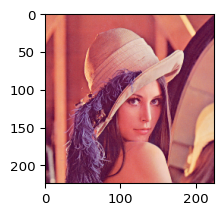

In [6]:
image = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")


# aug=iaa.Resize({"height": 132, "width": 448})
aug=iaa.Resize({"shorter-side": "keep-aspect-ratio", "longer-side": 224})

images_aug = aug(images=[image])

print(image.shape,'-->',images_aug[0].shape)
ia.imshow(images_aug[0])
# ia.imshow(np.hstack(images_aug[0].shape))


## Resize with Bounding Boxes

In [43]:
img.shape

(512, 512, 3)

BoundingBox(x1=39.0625, y1=42.9688, x2=156.2500, y2=160.1562, label=None)
BoundingBox(x1=19.5312, y1=19.5312, x2=35.1562, y2=35.1562, label=None)


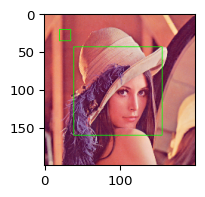

(200, 200, 3)


In [54]:
 
def imgAugResize(img,bs,longerSide=224,isImageWithBb=False):
    bbs = ia.BoundingBoxesOnImage(bs, shape=img.shape)
    seq = iaa.Sequential([
        iaa.Resize({"shorter-side": "keep-aspect-ratio", "longer-side": longerSide,"interpolation":"cubic" })
    ])
    seq_det = seq.to_deterministic()

    image_aug = seq_det.augment_images([img])[0]

    bbs_resized=seq_det.augment_bounding_boxes(bbs)
    # print(p,bbs_aug)


    image_aug=bbs_resized.draw_on_image(image_aug) if isImageWithBb else image_aug
    images_resized=image_aug

    return (images_resized,bbs_resized.bounding_boxes)



img = imageio.imread("https://upload.wikimedia.org/wikipedia/en/7/7d/Lenna_%28test_image%29.png")    
bs=[
    ia.BoundingBox(x1=100., y1=110., x2=400., y2=410),
    ia.BoundingBox(x1=50., y1=50., x2=90., y2=90)
]    

# ia.imshow(bbsOnImage(img,bs))
imgAndBb=imgAugResize(img,bs,200,True)
for i in imgAndBb[1]:
    print(i)
ia.imshow(imgAndBb[0])    
# ia.imshow(addBoudingBox(imgAndBb[0],imgAndBb[1]))
print(imgAndBb[0].shape)

# Read Write Bounding Box

In [1]:
import imgaug.augmenters as iaa
import imageio
import imgaug as ia
import numpy as np
import pandas as pd
import os
from matplotlib.pyplot import imsave

In [4]:
# !ls /prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/labels/000101_jpg.rf.53b8dc83db0defce0e4fb5cd63d7ee39.txt

In [146]:
# bb_path='/prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/labels/000101_jpg.rf.53b8dc83db0defce0e4fb5cd63d7ee39.txt'
# img_path='/prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/images/000101_jpg.rf.53b8dc83db0defce0e4fb5cd63d7ee39.jpg'
# image = imageio.imread(img_path)
# # ia.imshow(image)
# bbs=[]
# with open(bb_path) as f:
#     bbtext=f.readline()
    
#     print(bbtext.rstrip("\n").split(' '))
#     i,x1,y1,x2,y2=bbtext.rstrip("\n").split(' ')
#     # bbs.append(ia.BoundingBox(x1=x1, y1=y1, x2=x2, y2=y2))
#     bbs.append(ia.BoundingBox(x1=10.5, y1=20.5, x2=50.5, y2=30.5))

In [144]:
# bbsoi = ia.BoundingBoxesOnImage(bbs, shape=image.shape)
# image_with_bbs = bbsoi.draw_on_image(image)
# ia.imshow(image_with_bbs)


## bbsYolo5ToBbsImgAug

In [56]:
def bbsYolo5ToBbsImgAug(img,bbs):
    bbsImgAug=[]
    w=img.shape[1]
    h=img.shape[0]
    for r in bbs.iterrows():
        ll=r[1].to_list()
        wrh=ll[3]/2 # width ratio half
        hrh=ll[4]/2 # hight ratio half
        x1= ( ll[1]-wrh )*w
        x2= ( ll[1]+wrh )*w
        y1= ( ll[2]-hrh )*h
        y2= ( ll[2]+hrh )*h
        bbsImgAug.append(ia.BoundingBox(x1=x1, y1=y1, x2=x2, y2=y2,label=str(int(ll[0]))))
    return bbsImgAug

In [57]:

def addBoudingBox(img,bbs):
    bbsoi = ia.BoundingBoxesOnImage(
        bbsYolo5ToBbsImgAug(img,bbs) , 
        shape=img.shape
    )
    imgBouded = bbsoi.draw_on_image(img,color=(255, 0, 0), size=3)
    return imgBouded




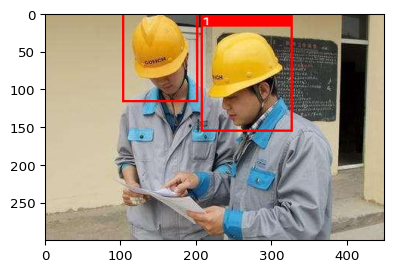

In [12]:
bb_path='/prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/labels/000101_jpg.rf.53b8dc83db0defce0e4fb5cd63d7ee39.txt'
img_path='/prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/images/000101_jpg.rf.53b8dc83db0defce0e4fb5cd63d7ee39.jpg'

img = imageio.imread(img_path)
bbs=pd.read_csv(bb_path,sep=" ", header=None)

ia.imshow(addBoudingBox(img,bbs))

In [151]:
bbs

,0,1,2,3,4
0,1,0.592222,0.285000,0.260000,0.456667
1,1,0.337778,0.191667,0.213333,0.383333


In [60]:
bbsImgAug=bbsYolo5ToBbsImgAug(img,bbs) 
bbsImgAug

AttributeError: 'BoundingBoxesOnImage' object has no attribute 'iterrows'

## bbsImgAugToBbsYolo5
- c0 : class
- c1 : 중앙에서 X축으로 이동된 비율
- c2 : 중앙에서 Y축으로 이동된 비율
- c3 : X축에서 차지하는 비율
- c4 : Y축이서 차지하는 비율

In [59]:
def bbsImgAugToBbsYolo5(img,bbs):
    bbsYolo5=[]
    w=img.shape[1] #  width
    h=img.shape[0] #  height
    ox=w/2  # origin x
    oy=h/2  # origin y
    for bb in bbs:
        c0=bb.label  # 현재는 한가지의 객체만 찾는 방식이라
        c1= ((bb.x2 + bb.x1)/2 ) / w
        c2= ((bb.y2 + bb.y1)/2) / h
        c3= abs(bb.x2 - bb.x1)/w
        c4= abs(bb.y2 - bb.y1)/h
        bbsYolo5.append([c0,c1,c2,c3,c4])
        df_bbsYolo5=pd.DataFrame(bbsYolo5)
    return df_bbsYolo5
bbs2=bbsImgAugToBbsYolo5(img,bbsImgAug)

NameError: name 'bbsImgAug' is not defined

In [154]:
bbs2

,0,1,2,3,4
0,1,0.592222,0.285000,0.260000,0.456667
1,1,0.337778,0.191667,0.213333,0.383333


In [155]:
bbsImgAug

[BoundingBox(x1=208.0000, y1=17.0000, x2=325.0000, y2=154.0000, label=1),
 BoundingBox(x1=104.0000, y1=-0.0000, x2=200.0000, y2=115.0000, label=1)]

In [209]:
bbs2.to_csv('/tmp/bbs2.txt',sep=' ',header=False,index=False)

In [210]:
!cat /tmp/bbs2.txt

1 0.5922222222222222 0.285 0.26 0.45666666666666667
1 0.3377777777777778 0.1916666666666666 0.2133333333333333 0.3833333333333333


# Resize Image and BoundingBox in path

In [1]:
basePath="/prj/nowage/ImgAugWithSR/imgs/HardHatSample__small/"
images_path       = basePath + "images/"
images_super_path = basePath + "images_super/"
labels_path       = basePath + "labels/"
labels_super_path = basePath + "labels_super/"

# !ls {images_path}

In [9]:
def resizeImageBatch(from_images_path, to_images_path,bbs_path,longerSide=224):
    file_list = os.listdir(from_images_path)
    for img_name in file_list:
        img=imageio.imread(from_images_path+img_name)
        bbs_name=img_name.replace('.jpg','.txt')
        bbsYolo5=pd.read_csv(bbs_path+bbs_name ,sep=" ",header=None)
        bbsImgAug=bbsYolo5ToBbsImgAug(img,bbsYolo5)

        imgAndBb=imgAugResize(img,bbsImgAug,longerSide,False)
        imsave(to_images_path+img_name,imgAndBb[0])
        
        # ia.imshow(bbsOnImage(imgAndBb[0],imgAndBb[1]))
        
resizeImageBatch(images_path, images_super_path,labels_path,300 )
    
# !ls {images_super_path}


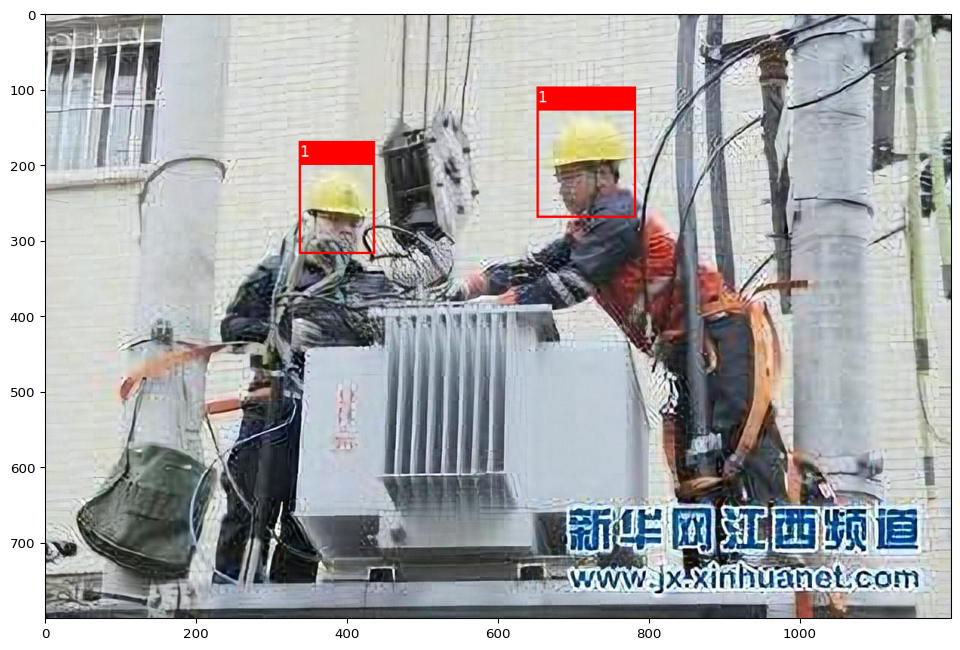

In [62]:
fname='000002_jpg.rf.14c099486ff0a2df2d20d82da93b46f5'
bb_path=labels_path+fname+'.txt'
img_path=images_super_path+fname+'.jpg'

img = imageio.imread(img_path)
bbsYolo5=pd.read_csv(bb_path,sep=" ", header=None)

ia.imshow(addBoudingBox(img,bbsYolo5))

In [63]:
bbsYolo5=pd.read_csv(bb_path,sep=" ", header=None,index_col=None)
bbsYolo5

,0,1,2,3,4
0,1,0.597,0.246246,0.106,0.174174
1,1,0.322,0.321321,0.080,0.144144


In [64]:
bbs

BoundingBoxesOnImage([BoundingBox(x1=278.5280, y1=81.4895, x2=332.8000, y2=170.6667, label=1), BoundingBox(x1=144.3840, y1=127.6156, x2=185.3440, y2=201.4174, label=1)], shape=(400, 400, 3))

   0         1         2      3         4
0  1  0.263667 -0.003754  0.106  0.174174
1  1 -0.011333  0.071321  0.080  0.144144
-----
   0         1         2      3         4
0  1 -0.069667 -0.253754  0.106  0.174174
1  1 -0.344667 -0.178679  0.080  0.144144
-----
   0         1         2      3         4
0  1 -0.069667 -0.003754  0.106  0.174174
1  1 -0.344667  0.071321  0.080  0.144144
-----
   0         1         2      3         4
0  1 -0.069667  0.246246  0.106  0.174174
1  1 -0.344667  0.321321  0.080  0.144144
-----
   0         1         2      3         4
0  1  0.263667 -0.253754  0.106  0.174174
1  1 -0.011333 -0.178679  0.080  0.144144
-----
   0         1         2      3         4
0  1  0.263667  0.246246  0.106  0.174174
1  1 -0.011333  0.321321  0.080  0.144144
-----
   0      1         2      3         4
0  1  0.597 -0.253754  0.106  0.174174
1  1  0.322 -0.178679  0.080  0.144144
-----
   0      1         2      3         4
0  1  0.597 -0.003754  0.106  0.174174
1  1  0

/prj/nowage/ImgAugWithSR/imgaug/imgaug/imgaug.py:1969: MatplotlibDeprecationWarning: 
The set_window_title function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use manager.set_window_title or GUI-specific methods instead.
  fig.canvas.set_window_title("imgaug.imshow(%s)" % (image.shape,))


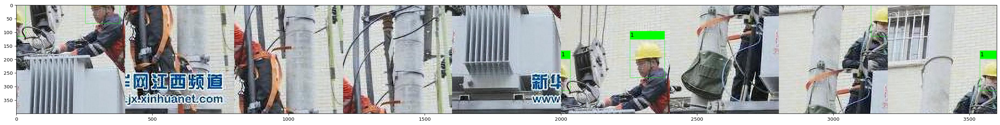

In [66]:


bbs=bbsYolo5ToBbsImgAug(img,bbsYolo5)
imgAndBb=imgAugCropTo9(img,bbs,True,400)
for bbs in imgAndBb[1]:
    print(bbsImgAugToBbsYolo5(img,bbs))
    print('-----')
ia.imshow(np.hstack(imgAndBb[0]))    
